In [ ]:
#!pip install plotly
#!pip install --upgrade nbformat
#!pip install nltk
#!pip install spacy # spaCy is an open-source software library for advanced natural language processing
#!pip install WordCloud
#!pip install gensim # Gensim is an open-source library for unsupervised topic modeling and natural language processing
#import nltk
#nltk.download('punkt')

## Libraries

In [1]:
# Libraries
import nltk
nltk.download('punkt')
import tensorflow as tf
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from wordcloud import WordCloud, STOPWORDS
import plotly.express as px
#import plotly.offline as pyo
#import plotly.io as pio
import re
from nltk.stem import PorterStemmer, WordNetLemmatizer
from nltk.corpus import stopwords
from nltk.tokenize import word_tokenize, sent_tokenize
import gensim
from gensim.utils import simple_preprocess
from gensim.parsing.preprocessing import STOPWORDS

from tensorflow.keras.preprocessing.text import one_hot, Tokenizer
from tensorflow.keras.preprocessing.sequence import pad_sequences
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Flatten, Embedding, Input, LSTM, Conv1D, MaxPool1D, Bidirectional
from tensorflow.keras.models import Model

from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score
from sklearn.metrics import confusion_matrix

from jupyterthemes import jtplot
jtplot.style(theme='monokai', context='notebook', ticks=True, grid=False) 
# setting the style of the notebook to be monokai theme  
# this line of code is important to ensure that we are able to see the x and y axes clearly
# If you don't run this code line, you will notice that the xlabel and ylabel on any plot is black on black and it will be hard to see them. 


[nltk_data] Downloading package punkt to /Users/MMbA/nltk_data...
[nltk_data]   Package punkt is already up-to-date!


## Data

In [2]:
# Load both news data files
df_real = pd.read_csv("data/True.csv")
df_fake = pd.read_csv("data/Fake.csv")

In [3]:
# View true news data 
df_real.head(10)

,title,text,subject,date
0,"As U.S. budget fight looms, Republicans flip t...",WASHINGTON (Reuters) - The head of a conservat...,politicsNews,"December 31, 2017"
1,U.S. military to accept transgender recruits o...,WASHINGTON (Reuters) - Transgender people will...,politicsNews,"December 29, 2017"
2,Senior U.S. Republican senator: 'Let Mr. Muell...,WASHINGTON (Reuters) - The special counsel inv...,politicsNews,"December 31, 2017"
3,FBI Russia probe helped by Australian diplomat...,WASHINGTON (Reuters) - Trump campaign adviser ...,politicsNews,"December 30, 2017"
4,Trump wants Postal Service to charge 'much mor...,SEATTLE/WASHINGTON (Reuters) - President Donal...,politicsNews,"December 29, 2017"
5,"White House, Congress prepare for talks on spe...","WEST PALM BEACH, Fla./WASHINGTON (Reuters) - T...",politicsNews,"December 29, 2017"
6,"Trump says Russia probe will be fair, but time...","WEST PALM BEACH, Fla (Reuters) - President Don...",politicsNews,"December 29, 2017"
7,Factbox: Trump on Twitter (Dec 29) - Approval ...,The following statements were posted to the ve...,politicsNews,"December 29, 2017"
8,Trump on Twitter (Dec 28) - Global Warming,The following statements were posted to the ve...,politicsNews,"December 29, 2017"
9,Alabama official to certify Senator-elect Jone...,WASHINGTON (Reuters) - Alabama Secretary of St...,politicsNews,"December 28, 2017"


In [4]:
# View fake news data 
df_fake.head(10)

,title,text,subject,date
0,Donald Trump Sends Out Embarrassing New Year’...,Donald Trump just couldn t wish all Americans ...,News,"December 31, 2017"
1,Drunk Bragging Trump Staffer Started Russian ...,House Intelligence Committee Chairman Devin Nu...,News,"December 31, 2017"
2,Sheriff David Clarke Becomes An Internet Joke...,"On Friday, it was revealed that former Milwauk...",News,"December 30, 2017"
3,Trump Is So Obsessed He Even Has Obama’s Name...,"On Christmas day, Donald Trump announced that ...",News,"December 29, 2017"
4,Pope Francis Just Called Out Donald Trump Dur...,Pope Francis used his annual Christmas Day mes...,News,"December 25, 2017"
5,Racist Alabama Cops Brutalize Black Boy While...,The number of cases of cops brutalizing and ki...,News,"December 25, 2017"
6,"Fresh Off The Golf Course, Trump Lashes Out A...",Donald Trump spent a good portion of his day a...,News,"December 23, 2017"
7,Trump Said Some INSANELY Racist Stuff Inside ...,In the wake of yet another court decision that...,News,"December 23, 2017"
8,Former CIA Director Slams Trump Over UN Bully...,Many people have raised the alarm regarding th...,News,"December 22, 2017"
9,WATCH: Brand-New Pro-Trump Ad Features So Muc...,Just when you might have thought we d get a br...,News,"December 21, 2017"


### MINI CHALLENGE #1:

    Indicate how many data samples do we have per class (i.e.: Fake and True)
    List how many Null element are present and the memory usage for each dataframe

In [5]:
print("Number of rows in real news dataframe: ", len(df_real))
print("Number of rows in fake news dataframe: ", len(df_fake))

Number of rows in real news dataframe:  21417
Number of rows in fake news dataframe:  23481


In [6]:
print("Number of Null rows in real news dataframe: ", df_real.isnull().sum())
print("\r")
print("Number of Null rows in fake news dataframe: ", df_fake.isnull().sum())

Number of Null rows in real news dataframe:  title      0
text       0
subject    0
date       0
dtype: int64

Number of Null rows in fake news dataframe:  title      0
text       0
subject    0
date       0
dtype: int64


In [7]:
print("Memory usage by real news dataframe: ", df_real.info())
print("\r")
print("Memory usage by fake news dataframe: ", df_fake.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 21417 entries, 0 to 21416
Data columns (total 4 columns):
 #   Column   Non-Null Count  Dtype 
---  ------   --------------  ----- 
 0   title    21417 non-null  object
 1   text     21417 non-null  object
 2   subject  21417 non-null  object
 3   date     21417 non-null  object
dtypes: object(4)
memory usage: 669.4+ KB
Memory usage by real news dataframe:  None

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 23481 entries, 0 to 23480
Data columns (total 4 columns):
 #   Column   Non-Null Count  Dtype 
---  ------   --------------  ----- 
 0   title    23481 non-null  object
 1   text     23481 non-null  object
 2   subject  23481 non-null  object
 3   date     23481 non-null  object
dtypes: object(4)
memory usage: 733.9+ KB
Memory usage by fake news dataframe:  None


## Data Wrangling

In [8]:
# Add a isfake target column to real news df to indicate whether the news is real ie isfake=0 (not fake)
print("Real news data")
df_real['isfake'] = 1 
df_real.head(10)

Real news data


,title,text,subject,date,isfake
0,"As U.S. budget fight looms, Republicans flip t...",WASHINGTON (Reuters) - The head of a conservat...,politicsNews,"December 31, 2017",1
1,U.S. military to accept transgender recruits o...,WASHINGTON (Reuters) - Transgender people will...,politicsNews,"December 29, 2017",1
2,Senior U.S. Republican senator: 'Let Mr. Muell...,WASHINGTON (Reuters) - The special counsel inv...,politicsNews,"December 31, 2017",1
3,FBI Russia probe helped by Australian diplomat...,WASHINGTON (Reuters) - Trump campaign adviser ...,politicsNews,"December 30, 2017",1
4,Trump wants Postal Service to charge 'much mor...,SEATTLE/WASHINGTON (Reuters) - President Donal...,politicsNews,"December 29, 2017",1
5,"White House, Congress prepare for talks on spe...","WEST PALM BEACH, Fla./WASHINGTON (Reuters) - T...",politicsNews,"December 29, 2017",1
6,"Trump says Russia probe will be fair, but time...","WEST PALM BEACH, Fla (Reuters) - President Don...",politicsNews,"December 29, 2017",1
7,Factbox: Trump on Twitter (Dec 29) - Approval ...,The following statements were posted to the ve...,politicsNews,"December 29, 2017",1
8,Trump on Twitter (Dec 28) - Global Warming,The following statements were posted to the ve...,politicsNews,"December 29, 2017",1
9,Alabama official to certify Senator-elect Jone...,WASHINGTON (Reuters) - Alabama Secretary of St...,politicsNews,"December 28, 2017",1


In [9]:
# Add a isfake target column to fake news df to indicate whether the news is real ie isfake=1 (is fake)
print("Fake news data")
df_fake['isfake'] = 0
df_fake.head(10)

Fake news data


,title,text,subject,date,isfake
0,Donald Trump Sends Out Embarrassing New Year’...,Donald Trump just couldn t wish all Americans ...,News,"December 31, 2017",0
1,Drunk Bragging Trump Staffer Started Russian ...,House Intelligence Committee Chairman Devin Nu...,News,"December 31, 2017",0
2,Sheriff David Clarke Becomes An Internet Joke...,"On Friday, it was revealed that former Milwauk...",News,"December 30, 2017",0
3,Trump Is So Obsessed He Even Has Obama’s Name...,"On Christmas day, Donald Trump announced that ...",News,"December 29, 2017",0
4,Pope Francis Just Called Out Donald Trump Dur...,Pope Francis used his annual Christmas Day mes...,News,"December 25, 2017",0
5,Racist Alabama Cops Brutalize Black Boy While...,The number of cases of cops brutalizing and ki...,News,"December 25, 2017",0
6,"Fresh Off The Golf Course, Trump Lashes Out A...",Donald Trump spent a good portion of his day a...,News,"December 23, 2017",0
7,Trump Said Some INSANELY Racist Stuff Inside ...,In the wake of yet another court decision that...,News,"December 23, 2017",0
8,Former CIA Director Slams Trump Over UN Bully...,Many people have raised the alarm regarding th...,News,"December 22, 2017",0
9,WATCH: Brand-New Pro-Trump Ad Features So Muc...,Just when you might have thought we d get a br...,News,"December 21, 2017",0


In [10]:
# Join both real and fake news into 1 df
df_allnews = pd.concat([df_real, df_fake]).reset_index(drop = True)
df_allnews

,title,text,subject,date,isfake
0,"As U.S. budget fight looms, Republicans flip t...",WASHINGTON (Reuters) - The head of a conservat...,politicsNews,"December 31, 2017",1
1,U.S. military to accept transgender recruits o...,WASHINGTON (Reuters) - Transgender people will...,politicsNews,"December 29, 2017",1
2,Senior U.S. Republican senator: 'Let Mr. Muell...,WASHINGTON (Reuters) - The special counsel inv...,politicsNews,"December 31, 2017",1
3,FBI Russia probe helped by Australian diplomat...,WASHINGTON (Reuters) - Trump campaign adviser ...,politicsNews,"December 30, 2017",1
4,Trump wants Postal Service to charge 'much mor...,SEATTLE/WASHINGTON (Reuters) - President Donal...,politicsNews,"December 29, 2017",1
...,...,...,...,...,...
44893,McPain: John McCain Furious That Iran Treated ...,21st Century Wire says As 21WIRE reported earl...,Middle-east,"January 16, 2016",0
44894,JUSTICE? Yahoo Settles E-mail Privacy Class-ac...,21st Century Wire says It s a familiar theme. ...,Middle-east,"January 16, 2016",0
44895,Sunnistan: US and Allied ‘Safe Zone’ Plan to T...,Patrick Henningsen 21st Century WireRemember ...,Middle-east,"January 15, 2016",0
44896,How to Blow $700 Million: Al Jazeera America F...,21st Century Wire says Al Jazeera America will...,Middle-east,"January 14, 2016",0


In [11]:
# Get rid of date column (provides no value). Inplace=true to make sure the column is dropped permanently in memory as well.
df_allnews.drop(columns = ['date'], inplace = True)
df_allnews

,title,text,subject,isfake
0,"As U.S. budget fight looms, Republicans flip t...",WASHINGTON (Reuters) - The head of a conservat...,politicsNews,1
1,U.S. military to accept transgender recruits o...,WASHINGTON (Reuters) - Transgender people will...,politicsNews,1
2,Senior U.S. Republican senator: 'Let Mr. Muell...,WASHINGTON (Reuters) - The special counsel inv...,politicsNews,1
3,FBI Russia probe helped by Australian diplomat...,WASHINGTON (Reuters) - Trump campaign adviser ...,politicsNews,1
4,Trump wants Postal Service to charge 'much mor...,SEATTLE/WASHINGTON (Reuters) - President Donal...,politicsNews,1
...,...,...,...,...
44893,McPain: John McCain Furious That Iran Treated ...,21st Century Wire says As 21WIRE reported earl...,Middle-east,0
44894,JUSTICE? Yahoo Settles E-mail Privacy Class-ac...,21st Century Wire says It s a familiar theme. ...,Middle-east,0
44895,Sunnistan: US and Allied ‘Safe Zone’ Plan to T...,Patrick Henningsen 21st Century WireRemember ...,Middle-east,0
44896,How to Blow $700 Million: Al Jazeera America F...,21st Century Wire says Al Jazeera America will...,Middle-east,0


In [12]:
# Combine title and article of news together (to feed to LSTM) into a new column called fullarticle
df_allnews['fullarticle'] = df_allnews['title'] + ' ' + df_allnews['text']
df_allnews.head(10)

,title,text,subject,isfake,fullarticle
0,"As U.S. budget fight looms, Republicans flip t...",WASHINGTON (Reuters) - The head of a conservat...,politicsNews,1,"As U.S. budget fight looms, Republicans flip t..."
1,U.S. military to accept transgender recruits o...,WASHINGTON (Reuters) - Transgender people will...,politicsNews,1,U.S. military to accept transgender recruits o...
2,Senior U.S. Republican senator: 'Let Mr. Muell...,WASHINGTON (Reuters) - The special counsel inv...,politicsNews,1,Senior U.S. Republican senator: 'Let Mr. Muell...
3,FBI Russia probe helped by Australian diplomat...,WASHINGTON (Reuters) - Trump campaign adviser ...,politicsNews,1,FBI Russia probe helped by Australian diplomat...
4,Trump wants Postal Service to charge 'much mor...,SEATTLE/WASHINGTON (Reuters) - President Donal...,politicsNews,1,Trump wants Postal Service to charge 'much mor...
5,"White House, Congress prepare for talks on spe...","WEST PALM BEACH, Fla./WASHINGTON (Reuters) - T...",politicsNews,1,"White House, Congress prepare for talks on spe..."
6,"Trump says Russia probe will be fair, but time...","WEST PALM BEACH, Fla (Reuters) - President Don...",politicsNews,1,"Trump says Russia probe will be fair, but time..."
7,Factbox: Trump on Twitter (Dec 29) - Approval ...,The following statements were posted to the ve...,politicsNews,1,Factbox: Trump on Twitter (Dec 29) - Approval ...
8,Trump on Twitter (Dec 28) - Global Warming,The following statements were posted to the ve...,politicsNews,1,Trump on Twitter (Dec 28) - Global Warming The...
9,Alabama official to certify Senator-elect Jone...,WASHINGTON (Reuters) - Alabama Secretary of St...,politicsNews,1,Alabama official to certify Senator-elect Jone...


In [13]:
# Show that the title and article are combined into 1 column
df_allnews['fullarticle'][0]

'As U.S. budget fight looms, Republicans flip their fiscal script WASHINGTON (Reuters) - The head of a conservative Republican faction in the U.S. Congress, who voted this month for a huge expansion of the national debt to pay for tax cuts, called himself a “fiscal conservative” on Sunday and urged budget restraint in 2018. In keeping with a sharp pivot under way among Republicans, U.S. Representative Mark Meadows, speaking on CBS’ “Face the Nation,” drew a hard line on federal spending, which lawmakers are bracing to do battle over in January. When they return from the holidays on Wednesday, lawmakers will begin trying to pass a federal budget in a fight likely to be linked to other issues, such as immigration policy, even as the November congressional election campaigns approach in which Republicans will seek to keep control of Congress. President Donald Trump and his Republicans want a big budget increase in military spending, while Democrats also want proportional increases for non

In [14]:
# Download the stopwords
nltk.download("stopwords")

[nltk_data] Downloading package stopwords to /Users/MMbA/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


True

In [15]:
# Adding additional stopwords from nltk
#from nltk.corpus import stopwords
stop_words = stopwords.words('english')
stop_words.extend(['edu', 'subject', 'use'])
#stop_words

In [16]:
# Funciton to remove stopwords and words with 2 or less characters 
def preprocess(text):
    processedText = []
    tokensList = gensim.utils.simple_preprocess(text) #Convert a document into a list of lowercase tokens
    for token in tokensList:   
        if token not in gensim.parsing.preprocessing.STOPWORDS and len(token) > 3 and token not in stop_words:
            processedText.append(token)
    return processedText

In [17]:
#print(STOPWORDS)
STOPWORDS

frozenset({'a',
           'about',
           'above',
           'across',
           'after',
           'afterwards',
           'again',
           'against',
           'all',
           'almost',
           'alone',
           'along',
           'already',
           'also',
           'although',
           'always',
           'am',
           'among',
           'amongst',
           'amoungst',
           'amount',
           'an',
           'and',
           'another',
           'any',
           'anyhow',
           'anyone',
           'anything',
           'anyway',
           'anywhere',
           'are',
           'around',
           'as',
           'at',
           'back',
           'be',
           'became',
           'because',
           'become',
           'becomes',
           'becoming',
           'been',
           'before',
           'beforehand',
           'behind',
           'being',
           'below',
           'beside',
           'besides'

In [18]:
df_allnews

,title,text,subject,isfake,fullarticle
0,"As U.S. budget fight looms, Republicans flip t...",WASHINGTON (Reuters) - The head of a conservat...,politicsNews,1,"As U.S. budget fight looms, Republicans flip t..."
1,U.S. military to accept transgender recruits o...,WASHINGTON (Reuters) - Transgender people will...,politicsNews,1,U.S. military to accept transgender recruits o...
2,Senior U.S. Republican senator: 'Let Mr. Muell...,WASHINGTON (Reuters) - The special counsel inv...,politicsNews,1,Senior U.S. Republican senator: 'Let Mr. Muell...
3,FBI Russia probe helped by Australian diplomat...,WASHINGTON (Reuters) - Trump campaign adviser ...,politicsNews,1,FBI Russia probe helped by Australian diplomat...
4,Trump wants Postal Service to charge 'much mor...,SEATTLE/WASHINGTON (Reuters) - President Donal...,politicsNews,1,Trump wants Postal Service to charge 'much mor...
...,...,...,...,...,...
44893,McPain: John McCain Furious That Iran Treated ...,21st Century Wire says As 21WIRE reported earl...,Middle-east,0,McPain: John McCain Furious That Iran Treated ...
44894,JUSTICE? Yahoo Settles E-mail Privacy Class-ac...,21st Century Wire says It s a familiar theme. ...,Middle-east,0,JUSTICE? Yahoo Settles E-mail Privacy Class-ac...
44895,Sunnistan: US and Allied ‘Safe Zone’ Plan to T...,Patrick Henningsen 21st Century WireRemember ...,Middle-east,0,Sunnistan: US and Allied ‘Safe Zone’ Plan to T...
44896,How to Blow $700 Million: Al Jazeera America F...,21st Century Wire says Al Jazeera America will...,Middle-east,0,How to Blow $700 Million: Al Jazeera America F...


In [19]:
# Use preprocess function and store in new column clean
df_allnews['clean'] = df_allnews['fullarticle'].apply(preprocess)

In [20]:
# Original news before preprocess function
df_allnews['fullarticle'][0]

'As U.S. budget fight looms, Republicans flip their fiscal script WASHINGTON (Reuters) - The head of a conservative Republican faction in the U.S. Congress, who voted this month for a huge expansion of the national debt to pay for tax cuts, called himself a “fiscal conservative” on Sunday and urged budget restraint in 2018. In keeping with a sharp pivot under way among Republicans, U.S. Representative Mark Meadows, speaking on CBS’ “Face the Nation,” drew a hard line on federal spending, which lawmakers are bracing to do battle over in January. When they return from the holidays on Wednesday, lawmakers will begin trying to pass a federal budget in a fight likely to be linked to other issues, such as immigration policy, even as the November congressional election campaigns approach in which Republicans will seek to keep control of Congress. President Donald Trump and his Republicans want a big budget increase in military spending, while Democrats also want proportional increases for non

In [21]:
# Cleaned news after preprocess function
print(df_allnews['clean'][0])

['budget', 'fight', 'looms', 'republicans', 'flip', 'fiscal', 'script', 'washington', 'reuters', 'head', 'conservative', 'republican', 'faction', 'congress', 'voted', 'month', 'huge', 'expansion', 'national', 'debt', 'cuts', 'called', 'fiscal', 'conservative', 'sunday', 'urged', 'budget', 'restraint', 'keeping', 'sharp', 'pivot', 'republicans', 'representative', 'mark', 'meadows', 'speaking', 'face', 'nation', 'drew', 'hard', 'line', 'federal', 'spending', 'lawmakers', 'bracing', 'battle', 'january', 'return', 'holidays', 'wednesday', 'lawmakers', 'begin', 'trying', 'pass', 'federal', 'budget', 'fight', 'likely', 'linked', 'issues', 'immigration', 'policy', 'november', 'congressional', 'election', 'campaigns', 'approach', 'republicans', 'seek', 'control', 'congress', 'president', 'donald', 'trump', 'republicans', 'want', 'budget', 'increase', 'military', 'spending', 'democrats', 'want', 'proportional', 'increases', 'defense', 'discretionary', 'spending', 'programs', 'support', 'educati

In [22]:
# Complete df
df_allnews

,title,text,subject,isfake,fullarticle,clean
0,"As U.S. budget fight looms, Republicans flip t...",WASHINGTON (Reuters) - The head of a conservat...,politicsNews,1,"As U.S. budget fight looms, Republicans flip t...","[budget, fight, looms, republicans, flip, fisc..."
1,U.S. military to accept transgender recruits o...,WASHINGTON (Reuters) - Transgender people will...,politicsNews,1,U.S. military to accept transgender recruits o...,"[military, accept, transgender, recruits, mond..."
2,Senior U.S. Republican senator: 'Let Mr. Muell...,WASHINGTON (Reuters) - The special counsel inv...,politicsNews,1,Senior U.S. Republican senator: 'Let Mr. Muell...,"[senior, republican, senator, mueller, washing..."
3,FBI Russia probe helped by Australian diplomat...,WASHINGTON (Reuters) - Trump campaign adviser ...,politicsNews,1,FBI Russia probe helped by Australian diplomat...,"[russia, probe, helped, australian, diplomat, ..."
4,Trump wants Postal Service to charge 'much mor...,SEATTLE/WASHINGTON (Reuters) - President Donal...,politicsNews,1,Trump wants Postal Service to charge 'much mor...,"[trump, wants, postal, service, charge, amazon..."
...,...,...,...,...,...,...
44893,McPain: John McCain Furious That Iran Treated ...,21st Century Wire says As 21WIRE reported earl...,Middle-east,0,McPain: John McCain Furious That Iran Treated ...,"[mcpain, john, mccain, furious, iran, treated,..."
44894,JUSTICE? Yahoo Settles E-mail Privacy Class-ac...,21st Century Wire says It s a familiar theme. ...,Middle-east,0,JUSTICE? Yahoo Settles E-mail Privacy Class-ac...,"[justice, yahoo, settles, mail, privacy, class..."
44895,Sunnistan: US and Allied ‘Safe Zone’ Plan to T...,Patrick Henningsen 21st Century WireRemember ...,Middle-east,0,Sunnistan: US and Allied ‘Safe Zone’ Plan to T...,"[sunnistan, allied, safe, zone, plan, territor..."
44896,How to Blow $700 Million: Al Jazeera America F...,21st Century Wire says Al Jazeera America will...,Middle-east,0,How to Blow $700 Million: Al Jazeera America F...,"[blow, million, jazeera, america, finally, cal..."


In [23]:
# Get all the words from the df
words_list = []
for i in df_allnews.clean:
    for j in i:
        words_list.append(j)

In [24]:
# Dsiplay list of all words
words_list

['budget',
 'fight',
 'looms',
 'republicans',
 'flip',
 'fiscal',
 'script',
 'washington',
 'reuters',
 'head',
 'conservative',
 'republican',
 'faction',
 'congress',
 'voted',
 'month',
 'huge',
 'expansion',
 'national',
 'debt',
 'cuts',
 'called',
 'fiscal',
 'conservative',
 'sunday',
 'urged',
 'budget',
 'restraint',
 'keeping',
 'sharp',
 'pivot',
 'republicans',
 'representative',
 'mark',
 'meadows',
 'speaking',
 'face',
 'nation',
 'drew',
 'hard',
 'line',
 'federal',
 'spending',
 'lawmakers',
 'bracing',
 'battle',
 'january',
 'return',
 'holidays',
 'wednesday',
 'lawmakers',
 'begin',
 'trying',
 'pass',
 'federal',
 'budget',
 'fight',
 'likely',
 'linked',
 'issues',
 'immigration',
 'policy',
 'november',
 'congressional',
 'election',
 'campaigns',
 'approach',
 'republicans',
 'seek',
 'control',
 'congress',
 'president',
 'donald',
 'trump',
 'republicans',
 'want',
 'budget',
 'increase',
 'military',
 'spending',
 'democrats',
 'want',
 'proportional',
 '

In [25]:
# Check how many words in the list
len(words_list)

9277072

In [26]:
# Get the total number of unique words with set function
total_words = len(list(set(words_list)))
total_words

108705

In [27]:
# Combine all the words (seperated by a space) into 1 string and store in new column clean_combined
df_allnews['clean_combined'] = df_allnews['clean'].apply(lambda x: " ".join(x))

In [28]:
# Show the updated df
df_allnews

,title,text,subject,isfake,fullarticle,clean,clean_combined
0,"As U.S. budget fight looms, Republicans flip t...",WASHINGTON (Reuters) - The head of a conservat...,politicsNews,1,"As U.S. budget fight looms, Republicans flip t...","[budget, fight, looms, republicans, flip, fisc...",budget fight looms republicans flip fiscal scr...
1,U.S. military to accept transgender recruits o...,WASHINGTON (Reuters) - Transgender people will...,politicsNews,1,U.S. military to accept transgender recruits o...,"[military, accept, transgender, recruits, mond...",military accept transgender recruits monday pe...
2,Senior U.S. Republican senator: 'Let Mr. Muell...,WASHINGTON (Reuters) - The special counsel inv...,politicsNews,1,Senior U.S. Republican senator: 'Let Mr. Muell...,"[senior, republican, senator, mueller, washing...",senior republican senator mueller washington r...
3,FBI Russia probe helped by Australian diplomat...,WASHINGTON (Reuters) - Trump campaign adviser ...,politicsNews,1,FBI Russia probe helped by Australian diplomat...,"[russia, probe, helped, australian, diplomat, ...",russia probe helped australian diplomat washin...
4,Trump wants Postal Service to charge 'much mor...,SEATTLE/WASHINGTON (Reuters) - President Donal...,politicsNews,1,Trump wants Postal Service to charge 'much mor...,"[trump, wants, postal, service, charge, amazon...",trump wants postal service charge amazon shipm...
...,...,...,...,...,...,...,...
44893,McPain: John McCain Furious That Iran Treated ...,21st Century Wire says As 21WIRE reported earl...,Middle-east,0,McPain: John McCain Furious That Iran Treated ...,"[mcpain, john, mccain, furious, iran, treated,...",mcpain john mccain furious iran treated sailor...
44894,JUSTICE? Yahoo Settles E-mail Privacy Class-ac...,21st Century Wire says It s a familiar theme. ...,Middle-east,0,JUSTICE? Yahoo Settles E-mail Privacy Class-ac...,"[justice, yahoo, settles, mail, privacy, class...",justice yahoo settles mail privacy class actio...
44895,Sunnistan: US and Allied ‘Safe Zone’ Plan to T...,Patrick Henningsen 21st Century WireRemember ...,Middle-east,0,Sunnistan: US and Allied ‘Safe Zone’ Plan to T...,"[sunnistan, allied, safe, zone, plan, territor...",sunnistan allied safe zone plan territorial bo...
44896,How to Blow $700 Million: Al Jazeera America F...,21st Century Wire says Al Jazeera America will...,Middle-east,0,How to Blow $700 Million: Al Jazeera America F...,"[blow, million, jazeera, america, finally, cal...",blow million jazeera america finally calls qui...


In [29]:
# Show the first row
df_allnews['clean_combined'][0]

'budget fight looms republicans flip fiscal script washington reuters head conservative republican faction congress voted month huge expansion national debt cuts called fiscal conservative sunday urged budget restraint keeping sharp pivot republicans representative mark meadows speaking face nation drew hard line federal spending lawmakers bracing battle january return holidays wednesday lawmakers begin trying pass federal budget fight likely linked issues immigration policy november congressional election campaigns approach republicans seek control congress president donald trump republicans want budget increase military spending democrats want proportional increases defense discretionary spending programs support education scientific research infrastructure public health environmental protection trump administration willing going increase defense discretionary spending percent meadows chairman small influential house freedom caucus said program democrats saying need government raise 

### MINI CHALLENGE #2:
    Perform sanity check on the prepocessing stage by visualizing at least 3 sample news 

In [30]:
df_allnews['fullarticle'][1]

'U.S. military to accept transgender recruits on Monday: Pentagon WASHINGTON (Reuters) - Transgender people will be allowed for the first time to enlist in the U.S. military starting on Monday as ordered by federal courts, the Pentagon said on Friday, after President Donald Trump’s administration decided not to appeal rulings that blocked his transgender ban. Two federal appeals courts, one in Washington and one in Virginia, last week rejected the administration’s request to put on hold orders by lower court judges requiring the military to begin accepting transgender recruits on Jan. 1. A Justice Department official said the administration will not challenge those rulings. “The Department of Defense has announced that it will be releasing an independent study of these issues in the coming weeks. So rather than litigate this interim appeal before that occurs, the administration has decided to wait for DOD’s study and will continue to defend the president’s lawful authority in District 

In [31]:
print(df_allnews['clean'][1])

['military', 'accept', 'transgender', 'recruits', 'monday', 'pentagon', 'washington', 'reuters', 'transgender', 'people', 'allowed', 'time', 'enlist', 'military', 'starting', 'monday', 'ordered', 'federal', 'courts', 'pentagon', 'said', 'friday', 'president', 'donald', 'trump', 'administration', 'decided', 'appeal', 'rulings', 'blocked', 'transgender', 'federal', 'appeals', 'courts', 'washington', 'virginia', 'week', 'rejected', 'administration', 'request', 'hold', 'orders', 'lower', 'court', 'judges', 'requiring', 'military', 'begin', 'accepting', 'transgender', 'recruits', 'justice', 'department', 'official', 'said', 'administration', 'challenge', 'rulings', 'department', 'defense', 'announced', 'releasing', 'independent', 'study', 'issues', 'coming', 'weeks', 'litigate', 'interim', 'appeal', 'occurs', 'administration', 'decided', 'wait', 'study', 'continue', 'defend', 'president', 'lawful', 'authority', 'district', 'court', 'meantime', 'official', 'said', 'speaking', 'condition', 'a

In [32]:
df_allnews['clean_combined'][1]

'military accept transgender recruits monday pentagon washington reuters transgender people allowed time enlist military starting monday ordered federal courts pentagon said friday president donald trump administration decided appeal rulings blocked transgender federal appeals courts washington virginia week rejected administration request hold orders lower court judges requiring military begin accepting transgender recruits justice department official said administration challenge rulings department defense announced releasing independent study issues coming weeks litigate interim appeal occurs administration decided wait study continue defend president lawful authority district court meantime official said speaking condition anonymity september pentagon said created panel senior officials study implement directive trump prohibit transgender individuals serving defense department submit plan trump lawyers representing currently serving transgender service members aspiring recruits sai

## Exploratory Data Analysis (EDA) of Cleaned Data

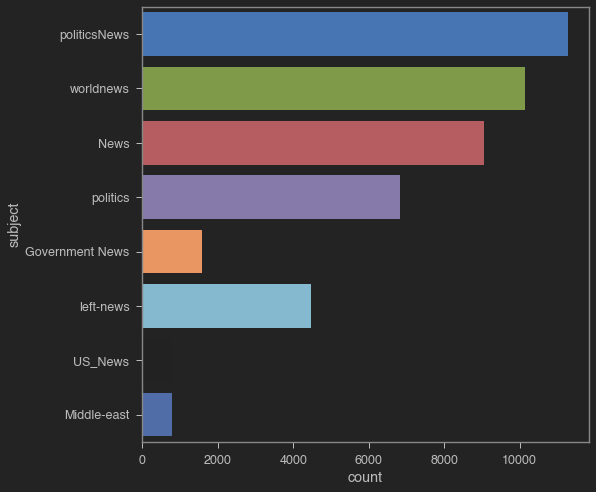

In [33]:
# Using Seaborn to plot the breakdown of samples in the subject column
plt.figure(figsize = (8, 8))
sns.countplot(y = "subject", data = df_allnews)

### MINI CHALLENGE #3: 
- Plot the count plot for fake vs. true news

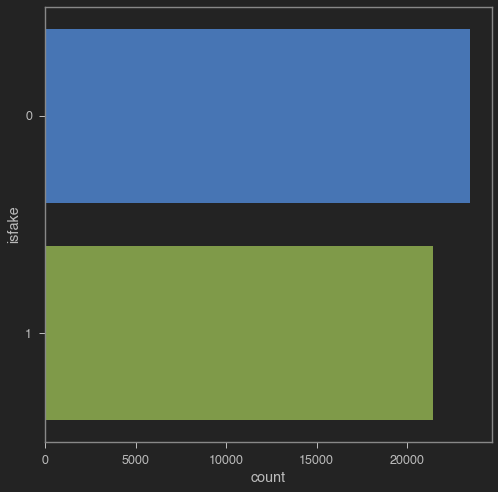

In [34]:
# Countplot of the breakdown in the subject column 
# Notice the plot shows that the dataset is almost balanced between real and fake news
plt.figure(figsize = (8, 8))
sns.countplot(y = "isfake", data = df_allnews)

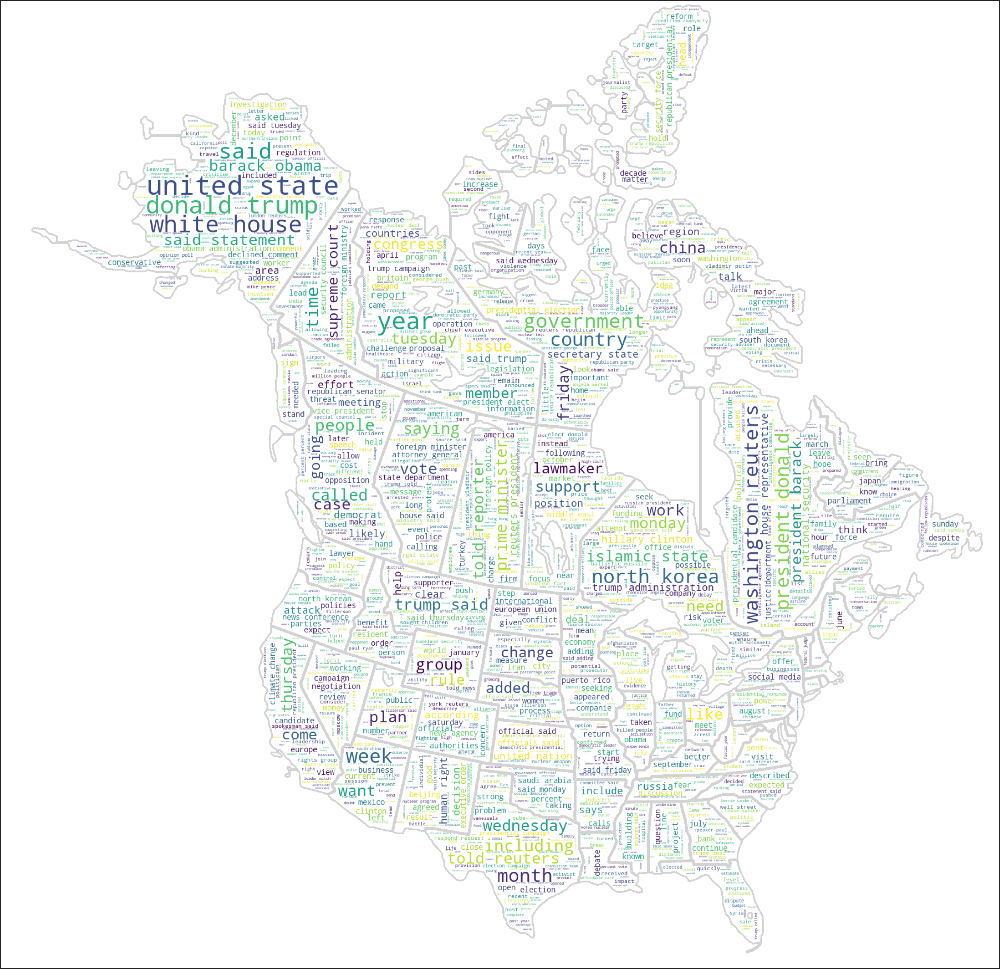

In [35]:
from PIL import Image

mask = np.array(Image.open('USACanada_BlankMap.png'))

wc = WordCloud(stopwords = stop_words, mask = mask, background_color = "white", 
               max_words = 2000, max_font_size = 256, contour_width = 2, contour_color = 'lightgrey',
               random_state = 42).generate(" ".join(df_allnews[df_allnews.isfake == 1].clean_combined))
               #width=mask.shape[1], 
               #height=mask.shape[0]).generate(" ".join(df_allnews[df_allnews.isfake == 1].clean_combined))
#wc.generate(article.text)


plt.figure(figsize=[200,100])
plt.imshow(wc, interpolation="bilinear")
plt.axis('off')
plt.show()


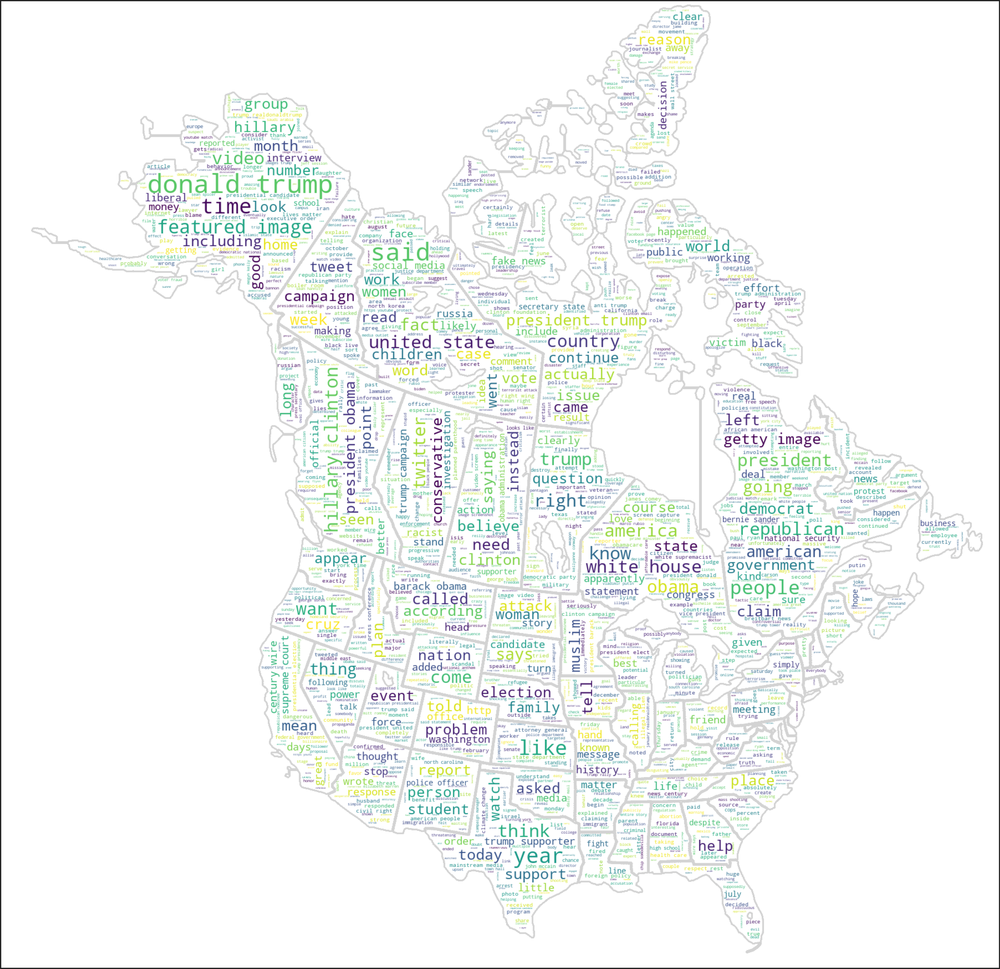

In [36]:
#from PIL import Image

#mask = np.array(Image.open('USACanada_BlankMap.png'))

wc = WordCloud(stopwords = stop_words, mask = mask, background_color = "white",
               max_words = 2000, max_font_size = 256, contour_width = 3, contour_color = 'lightgrey',
               random_state = 42).generate(" ".join(df_allnews[df_allnews.isfake == 0].clean_combined))
               #width=mask.shape[1], 
               #height=mask.shape[0]).generate(" ".join(df_allnews[df_allnews.isfake == 1].clean_combined))
#wc.generate(article.text)
plt.figure(figsize=[200,100])
plt.imshow(wc, interpolation="bilinear")
plt.axis('off')
plt.show()

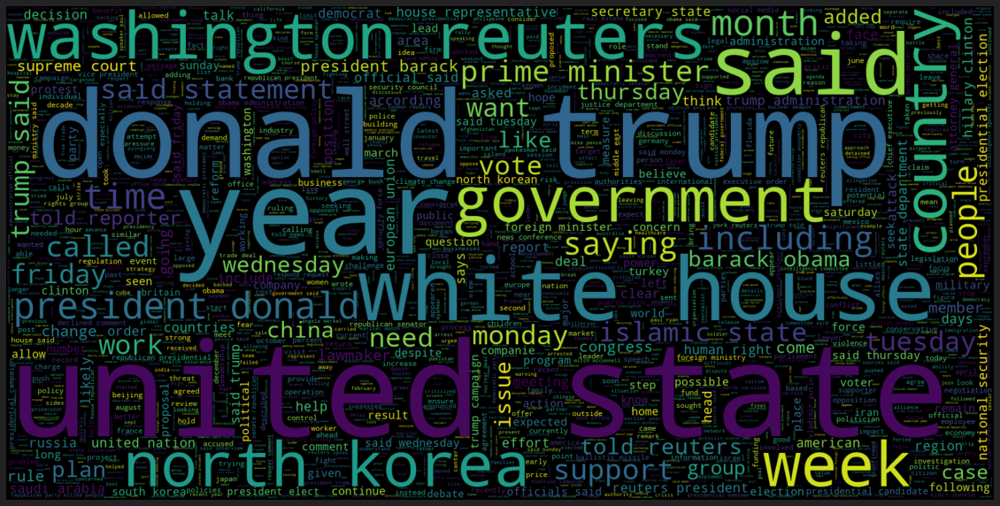

In [37]:
# Creating a word cloud plot for text that is real (isfake = 1)
plt.figure(figsize = (20, 20)) 
wc = WordCloud(max_words = 2000, width = 1600, height = 800, 
               stopwords = stop_words).generate(" ".join(df_allnews[df_allnews.isfake == 1].clean_combined))
plt.imshow(wc, interpolation = 'bilinear')
plt.axis('off')
plt.show()

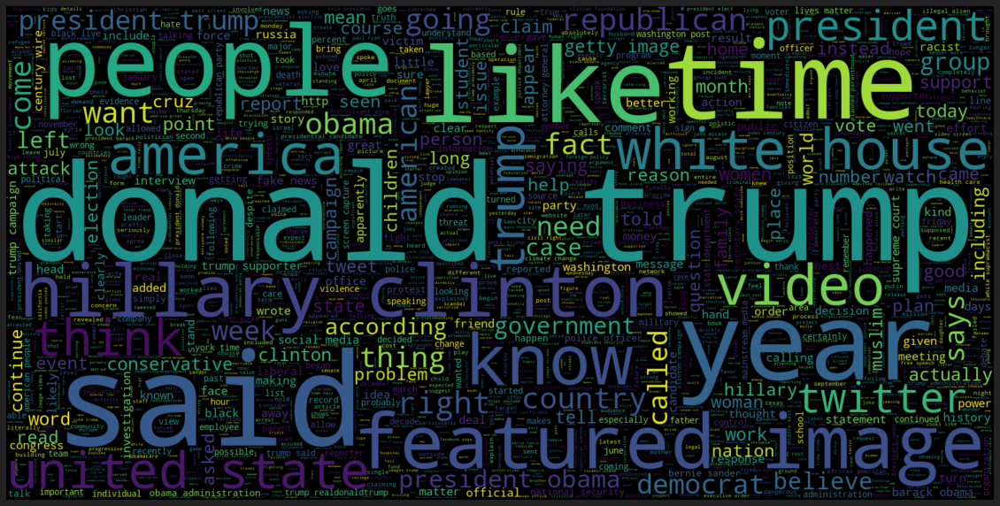

In [38]:
# Creating a word cloud plot for text that is fake (isfake = 0)
plt.figure(figsize = (20, 20)) 
wc = WordCloud(max_words = 2000, width = 1600, height = 800, 
               stopwords = stop_words).generate(" ".join(df_allnews[df_allnews.isfake == 0].clean_combined))
plt.imshow(wc, interpolation = 'bilinear')
plt.axis('off')
plt.show()

In [39]:
nltk.word_tokenize(df_allnews['clean_combined'][1]) #creates the tokens ie every unique word

['military',
 'accept',
 'transgender',
 'recruits',
 'monday',
 'pentagon',
 'washington',
 'reuters',
 'transgender',
 'people',
 'allowed',
 'time',
 'enlist',
 'military',
 'starting',
 'monday',
 'ordered',
 'federal',
 'courts',
 'pentagon',
 'said',
 'friday',
 'president',
 'donald',
 'trump',
 'administration',
 'decided',
 'appeal',
 'rulings',
 'blocked',
 'transgender',
 'federal',
 'appeals',
 'courts',
 'washington',
 'virginia',
 'week',
 'rejected',
 'administration',
 'request',
 'hold',
 'orders',
 'lower',
 'court',
 'judges',
 'requiring',
 'military',
 'begin',
 'accepting',
 'transgender',
 'recruits',
 'justice',
 'department',
 'official',
 'said',
 'administration',
 'challenge',
 'rulings',
 'department',
 'defense',
 'announced',
 'releasing',
 'independent',
 'study',
 'issues',
 'coming',
 'weeks',
 'litigate',
 'interim',
 'appeal',
 'occurs',
 'administration',
 'decided',
 'wait',
 'study',
 'continue',
 'defend',
 'president',
 'lawful',
 'authority',
 

In [40]:
# Get the maximum article length. This will be used to create word embeddings 
maxlength = -1
for article in df_allnews.clean_combined:
    tokens = nltk.word_tokenize(article) # creates the tokens ie every unique word
    if(maxlength < len(tokens)):
        maxlength = len(tokens)
print("The maximum number of words in any article is =", maxlength)

The maximum number of words in any article is = 4406


In [41]:
# Set notebook mode to work in offline
#pyo.init_notebook_mode()
#pio.renderers.default='notebook'

for x in df_allnews.clean_combined:
    len(nltk.word_tokenize(x))
        
# Using plotly to create a histogram (interactable) for the distribution of number of words in an article
maxLengthPlot = px.histogram(x = [len(nltk.word_tokenize(x)) for x in df_allnews.clean_combined], 
                             title='Distribution of Total Number of Words Per Article', 
                             labels={'x':'Number of Words Per Article'}, nbins = 100)
maxLengthPlot.show("notebook") # Forces the notebook renderer to reload to show plot

In [42]:
# Splitting data into train (80%) and test (20%) sets, x/input is clean_combined column, y/target/output is isfake column
#from sklearn.model_selection import train_test_split 
x_train, x_test, y_train, y_test = train_test_split(df_allnews.clean_combined, df_allnews.isfake, test_size = 0.2)

In [43]:
# Creating a tokenizer to tokenize the words and create sequences of tokenized words
#from nltk import word_tokenize
tokenizer = Tokenizer(num_words = total_words)
tokenizer.fit_on_texts(x_train) # Creates the vocabulary
train_sequences = tokenizer.texts_to_sequences(x_train) # Creates the sequence of integers
test_sequences = tokenizer.texts_to_sequences(x_test) # Creates the sequence of integers

In [44]:
# Checking train and test sequences
#len(train_sequences)
#train_sequences
#len(test_sequences)
#test_sequences

In [45]:
print("The encoding for document: \n\n", df_allnews.clean_combined[0], "\n\nis:\n\n", train_sequences[0])

The encoding for document: 

 budget fight looms republicans flip fiscal script washington reuters head conservative republican faction congress voted month huge expansion national debt cuts called fiscal conservative sunday urged budget restraint keeping sharp pivot republicans representative mark meadows speaking face nation drew hard line federal spending lawmakers bracing battle january return holidays wednesday lawmakers begin trying pass federal budget fight likely linked issues immigration policy november congressional election campaigns approach republicans seek control congress president donald trump republicans want budget increase military spending democrats want proportional increases defense discretionary spending programs support education scientific research infrastructure public health environmental protection trump administration willing going increase defense discretionary spending percent meadows chairman small influential house freedom caucus said program democrats 

In [55]:
# Adding padding can either be maxlength = 4406 (from above) or smaller number maxlength = 40 seems to work well based on results
# Pad sequences make all news articles the same length 
train_padded = pad_sequences(train_sequences, maxlen = 40, padding = 'post', truncating = 'post')
test_padded = pad_sequences(test_sequences, maxlen = 40, truncating = 'post') 

In [56]:
for i,doc in enumerate(train_padded[:2]):
    print("The padded encoding for article",i+1,"is: \n",doc)
    print("\n")

The padded encoding for article 1 is: 
 [  406     7   530  1546   452    24    89     5   506   297    46   140
   885   860  3213   651    11   673    41   632   860    22   184  2141
   420     7   530   817  3294  1549    68   452   183  9624   145 10857
  2629   291  1622    64]


The padded encoding for article 2 is: 
 [ 5797    24     5    65  1450   122   144   495   395  2307  4780  1205
   359    24   163  8766  1237    64   144  2680    21   425   431   107
   187    23   100    24     7     5  4961   986   122  2307  1623  3359
  3319 43127  2904  1756]




## Model

In [57]:
# Initializing the Sequential Model
fakenews_model = Sequential()

# Adding the embedding layer
fakenews_model.add(Embedding(total_words, output_dim = 128))
# fakenews_model.add(Embedding(total_words, output_dim = 240))

# Building a Bi-Directional RNN and LSTM model
fakenews_model.add(Bidirectional(LSTM(128)))

# Adding Dense layers
fakenews_model.add(Dense(128, activation = 'relu')) # adding 128 dense layers with relu activation 
# Output is only 1 neuron, why? Essentially doing binary classification with an output of 0 or 1
fakenews_model.add(Dense(1,activation= 'sigmoid')) # adding dense of 1 neuron with sigmoid activation
# compiling model with adam optimizer and binary crossentropy loss with metrics being accuracy
fakenews_model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['acc']) 
fakenews_model.summary()

# have approx 14Mil trainable parameters
# embedding layer for dimensionality reduction
# LSTM layer (bidirectional layer)
# 2 dense layers

Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
embedding_1 (Embedding)      (None, None, 128)         13914240  
_________________________________________________________________
bidirectional_1 (Bidirection (None, 256)               263168    
_________________________________________________________________
dense_2 (Dense)              (None, 128)               32896     
_________________________________________________________________
dense_3 (Dense)              (None, 1)                 129       
Total params: 14,210,433
Trainable params: 14,210,433
Non-trainable params: 0
_________________________________________________________________


In [58]:
total_words

108705

In [59]:
# Converting y train to an NumPy array, an important step before passing to the model
y_train = np.asarray(y_train)

In [60]:
# train the model
# input - padded_train, output - y_train
# Validation set as 10% of training data for cross validation, 90% for training
# only 2 epochs 
# if error is going down on both training and validation, thats good, it means model is able to generalize
# if error is going down for training but going up in validation, it means the model is overfitting the training data
fakenews_model.fit(train_padded, y_train, batch_size = 64, validation_split = 0.1, epochs = 2)

# in only 2 epochs
# can see performance is amazing! Accuracy ~99% for both, both losses also drop (training and validation)

Train on 32326 samples, validate on 3592 samples
Epoch 1/2
32326/32326 [==============================] - 152s 5ms/sample - loss: 0.0404 - acc: 0.9824 - val_loss: 0.0056 - val_acc: 0.9992
Epoch 2/2
32326/32326 [==============================] - 148s 5ms/sample - loss: 0.0022 - acc: 0.9995 - val_loss: 0.0064 - val_acc: 0.9983


### MINI CHALLENGE #4:
- Change the embedding output dimension and print out the model summary
- How many trainable parameters are there? 

In [61]:
# Initializing the Sequential Model
fakenews_model2 = Sequential()

# Adding the embedding layer
# fakenews_model2.add(Embedding(total_words, output_dim = 128))
fakenews_model2.add(Embedding(total_words, output_dim = 64))
# fakenews_model.add(Embedding(total_words, output_dim = 240))

# Building a Bi-Directional RNN and LSTM model
fakenews_model2.add(Bidirectional(LSTM(128)))

# Adding Dense layers
fakenews_model2.add(Dense(128, activation = 'relu')) # adding 128 dense layers with relu activation 
# Output is only 1 neuron, why? Essentially doing binary classification with an output of 0 or 1
fakenews_model2.add(Dense(1,activation= 'sigmoid')) # adding dense of 1 neuron with sigmoid activation
# compiling model with adam optimizer and binary crossentropy loss with metrics being accuracy
fakenews_model2.compile(optimizer='adam', loss='binary_crossentropy', metrics=['acc']) 
fakenews_model2.summary()

Model: "sequential_2"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
embedding_2 (Embedding)      (None, None, 64)          6957120   
_________________________________________________________________
bidirectional_2 (Bidirection (None, 256)               197632    
_________________________________________________________________
dense_4 (Dense)              (None, 128)               32896     
_________________________________________________________________
dense_5 (Dense)              (None, 1)                 129       
Total params: 7,187,777
Trainable params: 7,187,777
Non-trainable params: 0
_________________________________________________________________


In [62]:
# Initializing the Sequential Model
fakenews_model3 = Sequential()

# Adding the embedding layer
# fakenews_model2.add(Embedding(total_words, output_dim = 128))
# fakenews_model2.add(Embedding(total_words, output_dim = 64))
fakenews_model3.add(Embedding(total_words, output_dim = 240))

# Building a Bi-Directional RNN and LSTM model
fakenews_model3.add(Bidirectional(LSTM(128)))

# Adding Dense layers
fakenews_model3.add(Dense(128, activation = 'relu')) # adding 128 dense layers with relu activation 
# Output is only 1 neuron, why? Essentially doing binary classification with an output of 0 or 1
fakenews_model3.add(Dense(1,activation= 'sigmoid')) # adding dense of 1 neuron with sigmoid activation
# compiling model with adam optimizer and binary crossentropy loss with metrics being accuracy
fakenews_model3.compile(optimizer='adam', loss='binary_crossentropy', metrics=['acc']) 
fakenews_model3.summary()

Model: "sequential_3"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
embedding_3 (Embedding)      (None, None, 240)         26089200  
_________________________________________________________________
bidirectional_3 (Bidirection (None, 256)               377856    
_________________________________________________________________
dense_6 (Dense)              (None, 128)               32896     
_________________________________________________________________
dense_7 (Dense)              (None, 1)                 129       
Total params: 26,500,081
Trainable params: 26,500,081
Non-trainable params: 0
_________________________________________________________________


In [ ]:
# just changing 1 number (the putput dimension) can either use alot less or alot more computing resources and time

In [64]:
# making a prediction with the model
prediction = fakenews_model.predict(test_padded)
#prediction

In [65]:
# if the predicted value is > 0.5 it is real else it is fake
pred_vals = []
for i in range(len(prediction)):
    if prediction[i].item() > 0.5:
        pred_vals.append(1)
    else:
        pred_vals.append(0)

In [66]:
# Comparing accuracy between what was happening in reality (absolute truth, y_test) vs predictions (pred_vals)
# from sklearn.metrics import accuracy_score

accuracy = accuracy_score(list(y_test), pred_vals)

print("Model Accuracy : ", accuracy)

# 99% accuracy on testing data 

Model Accuracy :  0.9975501113585746


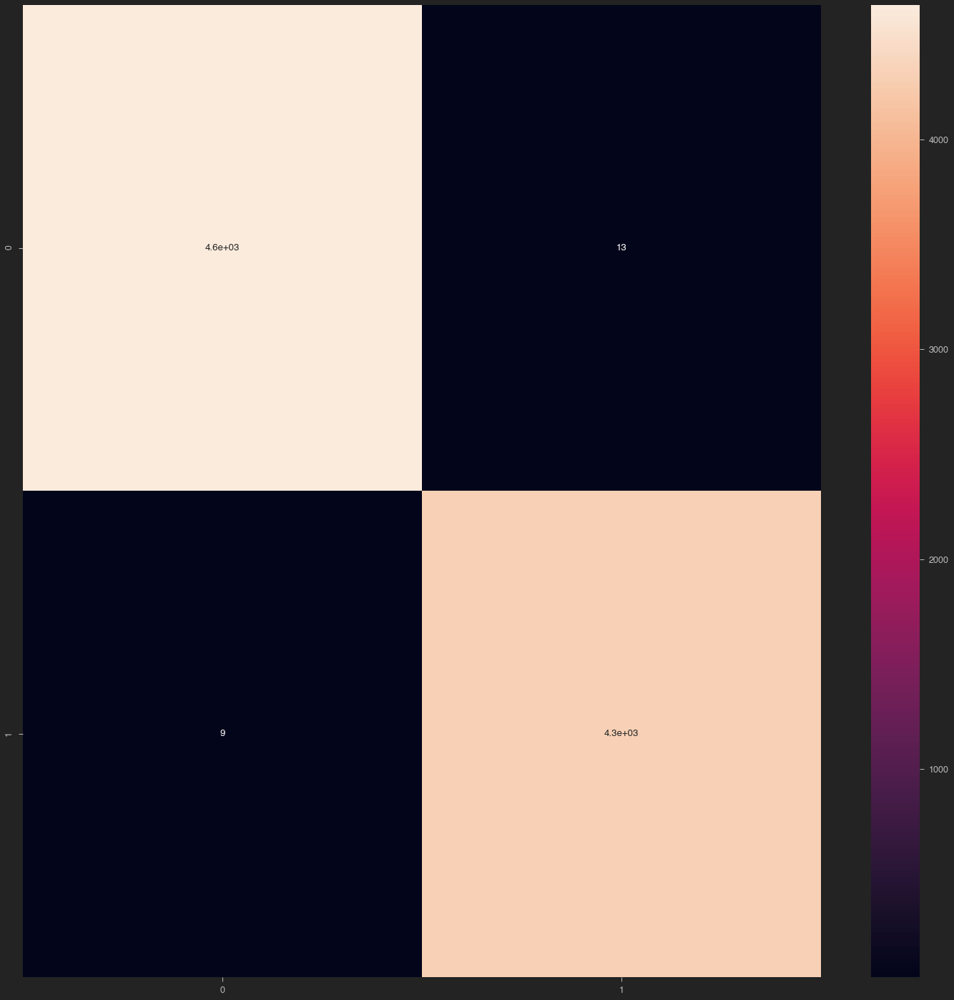

In [68]:
# get the confusion matrix to visualize predictions vs reality
# if predictions (1) match reality (1) for truth, then we have TPs
# if predictions is 0 and matches reality of 0, then we have TNs
# notice we misclassified 9 samples as FN and 13 samples as FP
# from sklearn.metrics import confusion_matrix
cm = confusion_matrix(list(y_test), pred_vals)
plt.figure(figsize = (25, 25))
sns.heatmap(cm, annot = True)

In [69]:
# category dict
category = { 0: 'Fake News', 1 : "Real News"}

In [74]:
cm = confusion_matrix(list(y_test), pred_vals)
cm

array([[4642,   13],
       [   9, 4316]])